# Introduction 
The goal of this capstone is to identify three potential stocks to invest in from all the stocks in the NYSE and the NASDAQ. This will be done by the following:    
    1. Stock scan of the enitre market based on key parameters    
    2. Creating interactive charts of filtered stock watch list   
    3. Modeling - Gradient Boosting, CNN, LSTM, and ARIMA
    
# Stock Scan 
The stock scan function below scrapes from two different APIs: NASDAQ.com and Tiingo.com. A list of stock tickers is generated and pulled from NASDAQ.com. The historical stock prices are then pulled from Tiingo.com and passed through a series of logic tests to filter further. Stocks that pass these logic test are appended to the stock watch list. The logic tests are the following:
   
   1. Does the stock idicate a bullish trend? I.e. is the 20 MA > 50 MA > 200 MA. If all these moving averages are in the right order the chart should show a stock that is in a bullish trend.
   
   
   2. Is the current stock in a bollinger band squeeze? Bollinger bands are a statistical chart indicator that show the prices and volatiliy over time. Gernerally they represent the potental price action within two standard deviations. Meaning that 95 percent of the price with fall somewhere within the band. A bollinger band squeeze occurs when the bands tighten. This indicates a drop in voliatility and most likely a spike in volatility will happen in the next few trading days. A stock that is bullish will breakout to the positive.
   
   
   3. Does the stock have a minimum average volume of over 500k a day. A low trade float indicates high volatility, large bid/ask spreads, and overall illiquidity. Meaning if the trade goes sour it will a painful lesson to our portfolio. So best avoid all together. 
   
   
   4. Is the stock close to the all time high? If a stock is close to its all time high it has the tendency to test its high. The high acts like a ceiling and it is easy to set up a trading strategy around it. Once the ceiling is broken a stock typically moves higher as there is no longer any selling pressure as buyers pour in fear of missing out (FOMO).
   
   
   5. Has the stock achieved a minimum of 10 percent ROI in the last year? This filter is to remove stocks that just slowly trade sideways. As the holding period idea for this form of trading is 10 - 20 days max. A stock with a low ROI will never see the gains this strategy needs within the holding period. 
   
   
   6. Is the stock within the 2 percent of the 50 MA? This is to identify stocks within an ideal entry point.  

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
from sklearn.preprocessing import StandardScaler, normalize
import warnings

# Create Chart
import alpaca_trade_api as tradeapi
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly import tools
from ipynb.fs.defs.add_features import add_features
from ipynb.fs.defs.create_chart import create_chart
from ipynb.fs.defs.roi_calc import roi_calc

# Market Scan
import os
import pandas_datareader as pdr
import time
from ipynb.fs.defs.market_scan import stock_scan

# Gradient Boosting 
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
import random 

# Time Series / ARIMA
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.arima_model import ARIMA
from pandas.plotting import autocorrelation_plot
from sklearn import metrics
from datetime import datetime, timedelta
from pmdarima import auto_arima

# Keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D
from keras.layers import LSTM, Dropout
from keras.callbacks import EarlyStopping

%matplotlib inline
warnings.filterwarnings('ignore')

In [2]:
# Tiingo API
api = '73d3a6aeca232c1374f0c610b84ad43e5700afd1'

# Run stock scan and print watch list
watch_list = stock_scan(api)
print(watch_list)

There are 3532 stocks in the NASDAQ
There are 3132 stocks in the NYSE
There are a combined total of 6091 stocks

--- 4644.0144147872925 seconds ---
['ASML', 'CY', 'GNTX', 'PEGI', 'PAYX', 'ADSW', 'APH', 'AJG', 'BAH', 'C', 'DEI', 'DRE', 'FNF', 'G', 'HIG', 'HON', 'KKR', 'MAS', 'RSG', 'SRE', 'SO', 'STAG', 'TPX', 'UTX']


In [3]:
# print length of watchlist
print('There are {} stock in the watch list'.format(len(watch_list)))

There are 24 stock in the watch list


## Stock Scan Results
The Stock scan produced an interesting list. It produced some very recognizable companies such as Costco, Oracle, and Walmart. It also produced companies that are more obscure such as Sunlife Financials. Let’s see how the charts of these stocks compare.

# Stock charts and Exploration
A stock chart will be produced below for each stock in the watchlist. There are several items that one is looking for. One, is to find any stocks that have a massive gap in their price action followed by side ways trading. These stocks do not have any momentum and will be dropped from the list. Second, is to make sure that the remaining stocks have charts that follow our filters above. The charts show the following items:

    1. OHLC candlesticks - these tell us the open, high, low, and close prices for each day. A green candle means it closed higher than it opened. A red candle indicates that it closed lower.
    2. Bollinger bands - the center line is typically the 20 MA. These are the potential price range of the stock. A stock has the propencity to move towards the center.
    3. 20 MA, 50 MA, and 200 MA - These technical indicators are strong support lines for the trend. When the trend line is broken the stock momentum will run out of steam and trade sideways. 
    4. Volume and average volume – This is a very interesting indicator. When the volume spikes with no tangible new from the company (such as earnings) it means that institutions are either buying or selling the stock. Institutions are banks, hedge funds, or brokerages. This can be an early indicator for future stock trend.

In [4]:
# Generate chart for each stock in the watch list
for x in watch_list:
    create_chart(x, api)

# Modeling
The goal of this section is to produce a model that can produce great results for forecasting stock prices. Four models will be implemented below:

    1.	Gradient Boosting
    2.	Convolutional Neural Network
    3.	Long Short-Term Memory
    4.	ARIMA 

For these models the first ticker from the stock list will be selected, which in this case is Costco. Additional features will be calculated from the OHLC data scraped from the Tiingo API. These features are the moving averages, the bollinger bands, and the average volume.


In [15]:
# Scrape API for historical data from the first ticker
# on watch list
df = pdr.get_data_tiingo(watch_list[0], api_key=api)
df = df.tail(1000)
df.reset_index(inplace=True)
df.index = df['date']

# Add MA, BB, and Average Volume
df = add_features(df)
df = df.tail(800)
df.tail()

,symbol,date,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,...,splitFactor,volume,20MA,50MA,200MA,20_day_std,upper_band,lower_band,width_%,avg_volume
date,,,,,,,,,,,,,,,,,,,,,
2019-11-26 00:00:00+00:00,ASML,2019-11-26 00:00:00+00:00,271.47,273.84,271.21,273.72,454831,271.47,0.0,273.84,...,1.0,454831,269.2785,259.2384,218.01840,3.118860,275.516220,263.040780,4.632913,547591.60
2019-11-27 00:00:00+00:00,ASML,2019-11-27 00:00:00+00:00,271.48,271.65,270.08,271.20,383301,271.48,0.0,271.65,...,1.0,383301,269.5700,259.6722,218.46425,3.033147,275.636293,263.503707,4.500718,541892.45
2019-11-29 00:00:00+00:00,ASML,2019-11-29 00:00:00+00:00,270.62,273.43,270.43,273.43,267557,270.62,0.0,273.43,...,1.0,267557,270.0025,260.0928,218.89570,2.453794,274.910088,265.094912,3.635216,523520.55
2019-12-02 00:00:00+00:00,ASML,2019-12-02 00:00:00+00:00,265.59,270.21,263.92,270.11,777790,265.59,0.0,270.21,...,1.0,777790,269.7520,260.4888,219.30180,2.638372,275.028744,264.475256,3.912293,531447.85
2019-12-03 00:00:00+00:00,ASML,2019-12-03 00:00:00+00:00,264.84,265.00,261.11,263.14,934456,264.84,0.0,265.00,...,1.0,934456,269.3350,260.8160,219.71370,2.725686,274.786372,263.883628,4.048023,544939.10


# Importance of Stationarity
Stationary means that the statistical properties of a time series does not change over time. This does not mean that the time series does not change, but rather the way it changes remains the same. See the chart below of the close price being transformed to a stationary process. The slope shifted to zero, which allows the data to be easier to analyze than that of non-stationary ones. This will help boost the accuracy of the models used below to predict stock movement. 


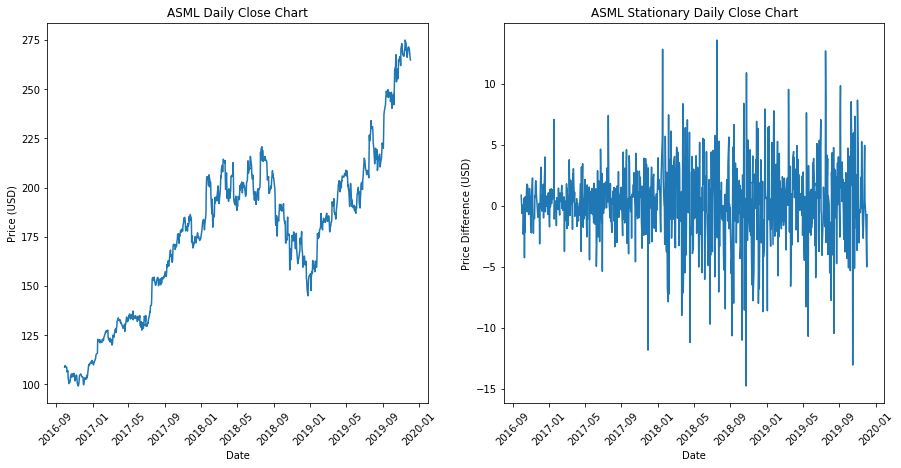

In [16]:
# Create new variable for stationary transformation of closing price
df['close_diff'] = df['close'] - df['close'].shift()

plt.figure(figsize=(15, 7))

# Plot chart of closing prices
plt.subplot(1, 2, 1)
plt.plot(df.index, df['close'])
plt.title('{} Daily Close Chart'.format(watch_list[0]))
plt.xticks(rotation=45)
plt.ylabel('Price (USD)')
plt.xlabel('Date')

# Plot chart of stationary closing price
plt.subplot(1, 2, 2)
plt.plot(df.index, df['close_diff'])
plt.title('{} Stationary Daily Close Chart'.format(watch_list[0]))
plt.xticks(rotation=45)
plt.ylabel('Price Difference (USD)')
plt.xlabel('Date')
plt.show()

## Correlation
Before the modeling will happen, lets take a quick look through the correlations of each variable to one another. Not surprisingly the features that were calculated are highly correlated with one another. These features will not be removed to see if the minute differences can generate a better model. 

In [17]:
# Drop unneeded columns
df.drop(['symbol', 'date', 'adjClose', 'adjHigh', 'adjLow', 
         'adjOpen', 'adjVolume', 'splitFactor'], axis=1, inplace=True)

# Drop any NA rows
df = df.dropna()
df.tail()

,close,divCash,high,low,open,volume,20MA,50MA,200MA,20_day_std,upper_band,lower_band,width_%,avg_volume,close_diff
date,,,,,,,,,,,,,,,
2019-11-26 00:00:00+00:00,271.47,0.0,273.84,271.21,273.72,454831,269.2785,259.2384,218.01840,3.118860,275.516220,263.040780,4.632913,547591.60,0.32
2019-11-27 00:00:00+00:00,271.48,0.0,271.65,270.08,271.20,383301,269.5700,259.6722,218.46425,3.033147,275.636293,263.503707,4.500718,541892.45,0.01
2019-11-29 00:00:00+00:00,270.62,0.0,273.43,270.43,273.43,267557,270.0025,260.0928,218.89570,2.453794,274.910088,265.094912,3.635216,523520.55,-0.86
2019-12-02 00:00:00+00:00,265.59,0.0,270.21,263.92,270.11,777790,269.7520,260.4888,219.30180,2.638372,275.028744,264.475256,3.912293,531447.85,-5.03
2019-12-03 00:00:00+00:00,264.84,0.0,265.00,261.11,263.14,934456,269.3350,260.8160,219.71370,2.725686,274.786372,263.883628,4.048023,544939.10,-0.75


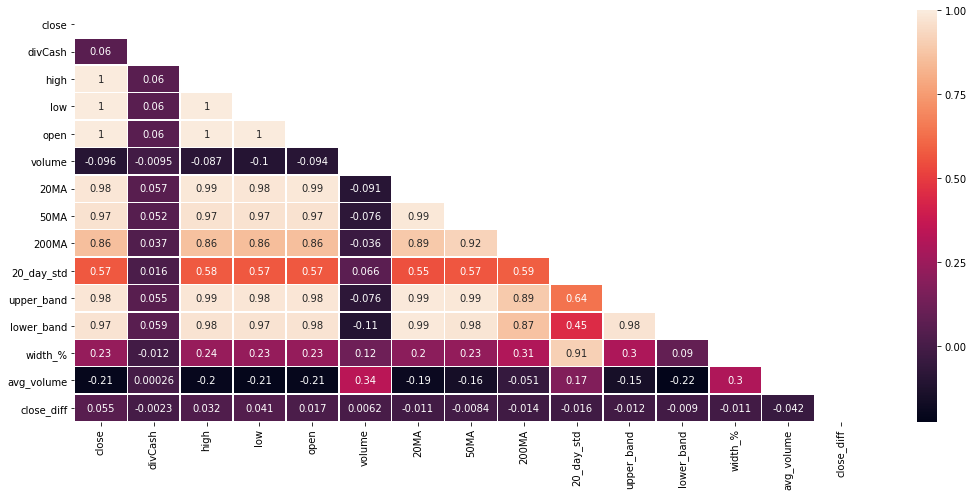

In [18]:
# plot correlation heatmap
df_cor = StandardScaler().fit_transform(df)
df_corr = df.corr()

# Plot correlation heatmap
plt.figure(figsize=(15, 7))

# Clean up the heatmap and remove repeat values
mask = np.zeros_like(df_corr)
mask[np.triu_indices_from(mask)] = True

# PLot the heatmap of the correlations
sns.heatmap(df_corr, annot=True, linewidths=.5, mask=mask)
plt.tight_layout()
plt.show()

# Gradient Boosting Regressor
As mentioned above Gradient Boosting Regressor IS WHAT. The following parameters were selected to go into a hyperparameter grid search:

    1.	n_estimators – number of boosting stages to perform
    2.	max_depth – depth of regression estimators in the tree
    3.	learning _rate – contribution of each tree
    4.	min_samples_split – minimum samples required for split a node
    5.	min_samples_leaf - minimum samples required for split a leaf

To find the ideal parameters, rather that iterate through each number in a range. Random integers will be selected to find the closest to ideal parameters. This will drastically reduce the running time but get close to perfect results. 


In [8]:
def Rand(start, end, num): 
    """ Return: List of random integers
    
    Parameters:
    start(int): Minimum list point
    end(int): Maximum list point
    num(int): Length of list"""
    
    res = [] 
    for j in range(num): 
        res.append(random.randint(start, end)) 
    return res 

## Standardization
The train and test set will be seperated before standardization of the features as the higher values of the test set will skew the training set. The test set will be standardized with the mean and standard deviation of the training set. If the testing set  were standardized with the training data or standardized  seperately it would leak information and cause optimism bias in the model. The idea in the model validation is to mimic the situation the model will be making production decisions. 

## Mapping
The training and test set needs to be remapped in order to use the current date to predict the future date. As such, all the target variables ('close price difference') were set to one day in the future. By doing this the model will be trained to predict one day in the future based on the current features.

In [90]:
# Split train and test data
train_set = df.head(780)
test_set = df.tail(20)

# Map data to training features and target variable
train_features = train_set.drop('close_diff', axis=1).iloc[:779]
X_train = StandardScaler().fit_transform(train_features)
Y_train = train_set['close_diff'].iloc[1:780]

# Map data to test features and target variable
test_features = test_set.drop('close_diff', axis=1).iloc[:19]
X_test = (test_features - train_features.mean()) / train_features.std()
Y_test = test_set['close_diff'].iloc[1:]

In [91]:
# Number of trees in random forest
n_estimators = Rand(5, 1000, 10)
n_estimators.append(10)

# Maximum number of levels in tree
max_depth = Rand(1, 10, 3)
max_depth.append(None)

# Minimum number of samples required to split a node
learning_rate = [.01, .1, .2]

# Minimum number of samples required to split a node
min_samples_split = Rand(2, 10, 3)

# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 3, 4]


# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'learning_rate': learning_rate,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf
              }

print(random_grid)

{'n_estimators': [640, 169, 355, 208, 31, 508, 91, 814, 638, 720, 10], 'max_depth': [10, 8, 1, None], 'learning_rate': [0.01, 0.1, 0.2], 'min_samples_split': [10, 3, 2], 'min_samples_leaf': [1, 2, 3, 4]}


In [92]:
# Use the random grid to search for best hyperparameters
gbr = GradientBoostingRegressor()

# Random search of parameters, using 2 fold cross validation, 
# Search across all combinations, and use all available cores
gbr_random = GridSearchCV(estimator=gbr, param_grid=random_grid, 
                         cv=2, verbose=2, n_jobs=-1)

# Fit the random search model
gbr_random.fit(X_train, Y_train)

print(gbr_random.best_params_)

Fitting 2 folds for each of 1584 candidates, totalling 3168 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   22.2s
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:   43.6s
[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 997 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 1442 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done 1969 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 2576 tasks      | elapsed:  3.9min


{'learning_rate': 0.01, 'max_depth': 1, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 10}


[Parallel(n_jobs=-1)]: Done 3168 out of 3168 | elapsed:  4.4min finished


In [93]:
# Fit best parameters to GBR and predict stock price change
params = gbr_random.best_params_
gbr = GradientBoostingRegressor(**params)

gbr.fit(X_train, Y_train)
Y_pred = gbr.predict(X_test)

In [94]:
# Print accuracy  metrics
mse = metrics.mean_squared_error(Y_test, Y_pred)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(Y_test, Y_pred)
print('Test MAE: {}'.format(round(mae, 3)))

Test MSE: 6.434
Test RMSE: 2.537
Test MAE: 2.02


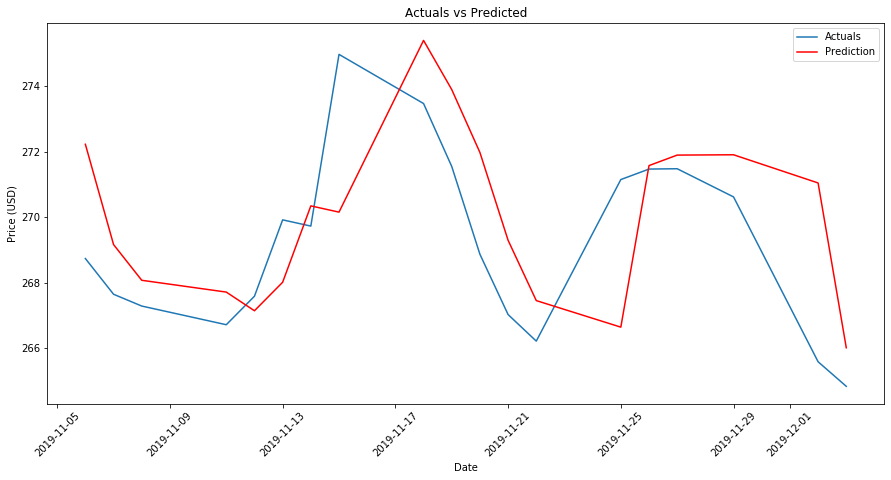

In [95]:
# Calculate the closing price based on the predicted change
closing_prices = df['close'][-20:-1]

predicted_close = []
for i, x in enumerate(closing_prices):
    x = x + Y_pred[i]
    predicted_close.append(x)

# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(df.index[780:], df['close'].iloc[-19:], label='Actuals')
plt.plot(df.index[780:], predicted_close, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.legend()

plt.show()

# Convolutional Neural Network (CNN)

In [69]:
# Split train and test data
train_set = df.head(790)
test_set = df.tail(11)

# Split target variable from features, standardize the features
# Add third dimension for CNN
train_features = train_set.drop('close_diff', axis=1)
X_train = StandardScaler().fit_transform(train_features)
X_train = np.expand_dims(X_train, axis=2)
Y_train = df['close_diff'].iloc[:790]

# Split target variable from features, standardize the features
# Add third dimension for CNN
test_features = test_set.drop('close_diff', axis=1).iloc[:10]
X_test = (test_features - train_features.mean()) / train_features.std()
X_test = np.expand_dims(X_test, axis=0)
Y_test = df['close_diff'].iloc[789:]

Now that the train and test data has been split, the sets need to be reshaped. The data will be reshaped to the following (batches, steps, channels). The steps is how many days for each batch in this case we are doing 10 due to our holding period. The 

In [70]:
# Reshape the training data to fit CNN model
X_train_reduced = X_train.reshape(79, 10, 14)
X_train_reduced = np.delete(X_train_reduced, 78, axis=0)
print(X_train_reduced.shape)
Y_train_reduced = Y_train[10:790:10]
print(Y_train_reduced.shape)

(78, 10, 14)
(78,)


In [71]:
model = Sequential()

# I: [38, 20, 13], O: [38, 10, 13]
model.add(Conv1D(filters=50, kernel_size=5, activation='relu', input_shape=(10, 14)))

# I:[38, 20, 13], O:[38, 20, 13]
model.add(MaxPooling1D(padding='same'))

# I:[38, 20, 13], O:[38, 20, 13]
model.add(Conv1D(filters=50, kernel_size=3, activation='relu', input_shape=(10, 14)))
model.add(MaxPooling1D(padding='same'))

model.add(Conv1D(filters=50, kernel_size=1, activation='relu', input_shape=(10, 14)))
model.add(MaxPooling1D(padding='same'))

model.add(Flatten())
model.add(Dense(1, activation='linear'))

model.compile(optimizer='adam', loss='mse', metrics=['mae', 'mape', 'acc'])

# fit model
model.fit(X_train_reduced, Y_train_reduced, batch_size = 100, epochs=1000, verbose=0, validation_split = 0.05,)


model.summary()

# Fit test data
Y_pred = model.predict(X_test)
print(Y_pred)

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_13 (Conv1D)           (None, 6, 50)             3550      
_________________________________________________________________
max_pooling1d_13 (MaxPooling (None, 3, 50)             0         
_________________________________________________________________
conv1d_14 (Conv1D)           (None, 1, 50)             7550      
_________________________________________________________________
max_pooling1d_14 (MaxPooling (None, 1, 50)             0         
_________________________________________________________________
conv1d_15 (Conv1D)           (None, 1, 50)             2550      
_________________________________________________________________
max_pooling1d_15 (MaxPooling (None, 1, 50)             0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 50)               

In [72]:
# Print predicted price against actual
print('The acutal close price of {} stock: {}'.format(
    watch_list[0], df['close'][-1]))

print('The predicted price of {} stock: {}'.format(
    watch_list[0], (df['close'][-2]+Y_pred)))

# Print Statistics
mse = (Y_test[-1]-Y_pred)**2
print('MSE: {}'.format(mse))
print('Test RMSE: {}'.format(np.sqrt(mse)))
mae = Y_pred - Y_test[-1]
print('Test MAE: {}'.format(mae))
mape = ((Y_test[-1] - Y_pred) / Y_test[-1])
print('Test MAPE: {}'.format(mape))

The acutal close price of ASML stock: 264.84
The predicted price of ASML stock: [[255.31383]]
MSE: [[90.747894]]
Test RMSE: [[9.526169]]
Test MAE: [[-9.526169]]
Test MAPE: [[-12.701558]]


# Long Short-Term Memory (LSTM)

In [96]:
# Split train and test data
train_set = df.head(780)
test_set = df.tail(20)

# Split target variable from features, standardize the features
# Add third dimension for LSTM
train_features = train_set.drop('close_diff', axis=1).iloc[0:779]
X_train = StandardScaler().fit_transform(train_features)
X_train = np.expand_dims(X_train, axis=2)
Y_train = df['close_diff'].iloc[1:780]

# Split target variable from features, standardize the features
# Add third dimension for LSTM
test_features = test_set.drop('close_diff', axis=1).iloc[0:19]
X_test = (test_features - train_features.mean()) / train_features.std()
X_test = np.expand_dims(X_test, axis=2)
Y_test = test_set['close_diff'].iloc[1:]

In [97]:
model = Sequential()
model.add(LSTM(30, input_shape=(14, 1)))
model.add(Dropout(0.2))
model.add(Dense(1, activation='linear'))

model.compile(optimizer='adam', loss='mse', metrics=['mae', 'mape', 'acc'])

history = model.fit(X_train, Y_train, epochs=1000, batch_size=100, verbose=0, shuffle=False)

model.summary()

# Fit test data
Y_pred = model.predict(X_test)

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 30)                3840      
_________________________________________________________________
dropout_6 (Dropout)          (None, 30)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 31        
Total params: 3,871
Trainable params: 3,871
Non-trainable params: 0
_________________________________________________________________


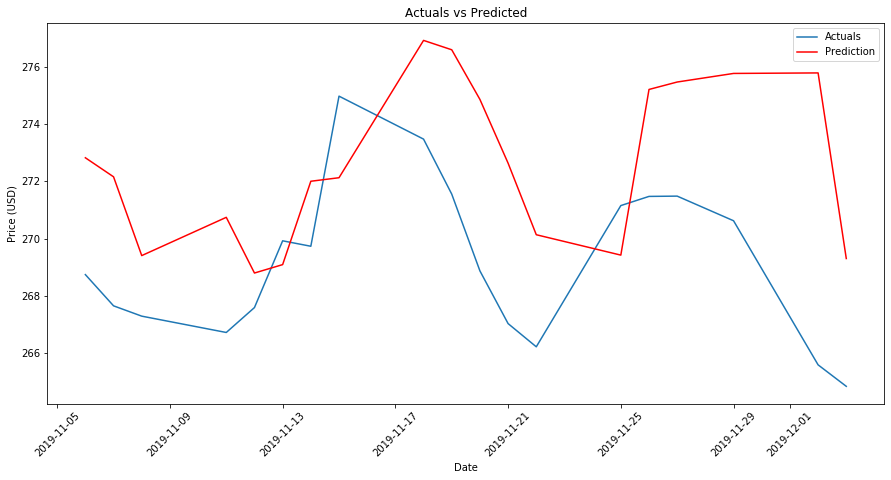

In [98]:
# Calculate the closing price based on the predicted change
closing_prices = df['close'][-20:-1]

predicted_close = []
for i, x in enumerate(closing_prices):
    x = x + Y_pred[i]
    predicted_close.append(x)

# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(Y_test.index, df['close'].iloc[-19:], label='Actuals')
plt.plot(Y_test.index, predicted_close, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.legend()

plt.show()

In [99]:
# Print accuracy metrics
mse = metrics.mean_squared_error(Y_test, Y_pred)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(Y_test, Y_pred)
print('Test MAE: {}'.format(round(mae, 3)))

Test MSE: 19.774
Test RMSE: 4.447
Test MAE: 3.952


# ARIMA

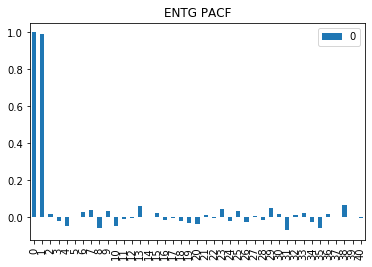

In [57]:
x_acf = pd.DataFrame(pacf(df['close']))
x_acf.plot(kind='bar')
plt.title("ENTG PACF")
plt.show()

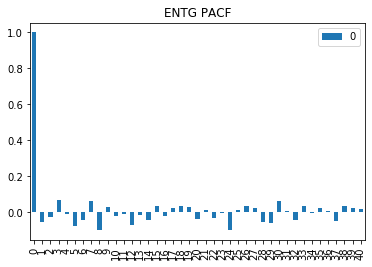

In [58]:
x_acf = pd.DataFrame(pacf(df['close_diff']))
x_acf.plot(kind='bar')
plt.title("ENTG PACF")
plt.show()

In [59]:
stepwise_model = auto_arima(df['close'], start_p=1, start_q=1,
                           max_p=20, max_q=20, m=1,
                           start_P=1, seasonal=True,
                           d=1, max_d=1, D=1,
                           error_action='ignore',  
                           suppress_warnings=True, 
                           stepwise=True)

print(stepwise_model)

ARIMA(callback=None, disp=0, maxiter=None, method=None, order=(2, 1, 2),
      out_of_sample_size=0, scoring='mse', scoring_args=None,
      seasonal_order=(0, 0, 0, 1), solver='lbfgs', start_params=None,
      suppress_warnings=True, transparams=True, trend=None,
      with_intercept=True)


In [60]:
df1= df['close']
X = df1.values
size = int(len(X) * 0.95)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
predictions = list()
for t in range(len(test)):
    model = ARIMA(history, order=(0,1,0))
    model_fit = model.fit(disp=0)
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    obs = test[t]
    history.append(obs)

mse = metrics.mean_squared_error(test, predictions)
print('Test MSE: {}'.format(round(mse, 3)))
print('Test RMSE: {}'.format(round(np.sqrt(mse), 3)))
mae = metrics.mean_absolute_error(test, predictions)
print('Test MAE: {}'.format(round(mae, 3)))
mape = np.mean(np.abs((test - predictions) / test)) * 100
print('Test MAPE: {}'.format(round(mape, 3)))

Test MSE: 17.346
Test RMSE: 4.165
Test MAE: 3.102
Test MAPE: 3.168


In [61]:
df['close'][-1]

264.84

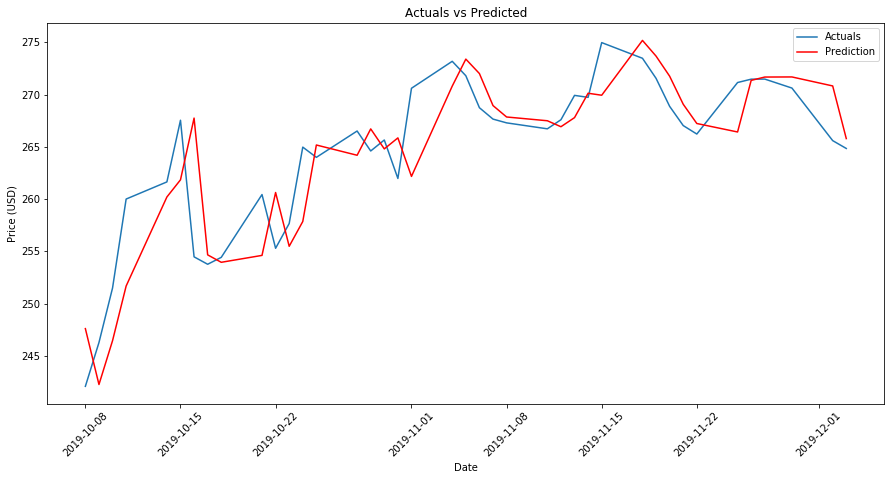

In [62]:
# Plot the stock price prediction vs actual
plt.figure(figsize=(15, 7))
plt.plot(df1.index[-40:], test, label='Actuals')
plt.plot(df1.index[-40:], predictions, color='red', label='Prediction')

plt.title('Actuals vs Predicted')
plt.ylabel('Price (USD)')
plt.xlabel('Date')
plt.xticks(rotation=45)

# Plot Legend
plt.legend()


plt.show()

# ARIMA Forcasting

In [ ]:
roi = roi_calc(watch_list, api)

In [ ]:
print(roi)

# Conclusion